In [1]:
import os
import os.path as osp
import torch
from torchvision import transforms
from torch.backends import cudnn
os.environ['CUDA_VISIBLE_DEVICES'] = '0' # new add by gu
torch.cuda.set_device(torch.device('cuda',0))
cudnn.benchmark = True
from datasets.custom_dataset import CustomDataSet
from model import Generator
import torch.nn.functional as F
from collections import defaultdict

In [2]:
def init_styleGAN(img_size=256,ckpt='./checkpoint/550000.pt'):
    g_ema = Generator(img_size, 512, 8)
    g_ema.load_state_dict(torch.load(ckpt)["g_ema"], strict=False)
    g_ema.eval()
    g_ema.to('cuda')
    return g_ema

g_ema = init_styleGAN()

In [3]:
latent_path =  "./projected_output/interpolate_pairs/projected_W_1000step_256_550000/projected_latent_dict"
latent_files = os.listdir(latent_path)
latent_pairs = defaultdict(lambda: defaultdict(str))
for latent_file in latent_files:
    img_id, img_tag =  latent_file.split("_")[:2]
    with open(osp.join(latent_path,latent_file),'rb') as f:
        latent_pairs[img_id][img_tag] = torch.load(f)
print(f"there are {len(latent_files)} latent files")

there are 16 latent files


In [4]:
latent_pairs

defaultdict(<function __main__.<lambda>>,
            {'6': defaultdict(str,
                         {'a': {'img': tensor([[[-0.8659, -0.8484, -0.8220,  ..., -0.7677, -0.8087, -0.7864],
                                    [-0.8765, -0.8323, -0.8444,  ..., -0.7653, -0.7616, -0.7933],
                                    [-0.8482, -0.8724, -0.8526,  ..., -0.7485, -0.7493, -0.7668],
                                    ...,
                                    [-0.3150, -0.2133, -0.1438,  ...,  0.7062,  0.7124,  0.7074],
                                    [-0.2516, -0.1855, -0.1225,  ...,  0.7325,  0.7098,  0.7226],
                                    [-0.2765, -0.1766, -0.1356,  ...,  0.7010,  0.7102,  0.7725]],
                           
                                   [[-0.8710, -0.8305, -0.8015,  ..., -0.7651, -0.7599, -0.7753],
                                    [-0.8476, -0.8201, -0.8234,  ..., -0.7588, -0.7543, -0.7456],
                                    [-0.8107, -0.8353, -0

In [11]:
import math
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm

def cos(a, b):
    a = a.view(-1)
    b = b.view(-1)
    a = F.normalize(a, dim=0)
    b = F.normalize(b, dim=0)
    return (a * b).sum()

def spherical_interpolation(x0, x1, alpha):
    theta = torch.acos(cos(x0, x1))   #torch.arccos(cos(x0, x1))
    a = torch.sin((1-alpha)*theta) / torch.sin(theta) * x0
    b = torch.sin(alpha*theta) / torch.sin(theta) * x1
    return a + b

def sqrt_interpolation(x0, x1, alpha):
    return ((1-alpha) * x0 + (alpha) * x1) / math.sqrt(alpha ** 2 + (1-alpha) ** 2)

def linear_interpolation(x0, x1, alpha):
    return ((1-alpha) * x0 + (alpha) * x1)    


/home/nessessence/anaconda3/envs/stylegan/lib/python3.6/site-packages/ipykernel_launcher.py:4: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  after removing the cwd from sys.path.


In [12]:
n_imgs = 7
alphas = np.linspace(0, 1, n_imgs)

def make_image(tensor):
    return (
        tensor.detach()
        .clamp_(min=-1, max=1)
        .add(1)
        .div_(2)
        .mul(255)
        .type(torch.uint8)
        .permute(0, 2, 3, 1)
        .to("cpu")
        .numpy()
    )
def post_processing(img_gen):
    channel, height, width = img_gen.shape
    if height > 256:
        factor = height // 256
        img_gen = img_gen.reshape(channel, height // factor, factor, width // factor, factor)
        img_gen = img_gen.mean([3, 5])
    
    return img_gen 
def pair_interpolate(noises1,noises2,latent1,latent2,alphas=alphas,w_plus=False):
    global g_ema
    interpolated_imgs = [] 
    for alpha in alphas:
        interpolated_noises = []
        for noise1, noise2 in zip(noises1,noises2):
            interpolated_noises += [spherical_interpolation(noise1, noise2, alpha)]
        if w_plus:
            interpolated_latent = torch.stack([linear_interpolation(latent1_a,latent2_b,alpha) for latent1_a,latent2_b in zip(latent1,latent2) ])
        else: interpolated_latent = linear_interpolation(latent1,latent2,alpha)
        # print(interpolated_latent.shape,interpolated_latent[None, :].shape )
        interpolated_img, _ = g_ema([interpolated_latent[None, :]], input_is_latent=True, noise=interpolated_noises)
        interpolated_img = make_image(interpolated_img)
        interpolated_imgs +=  [interpolated_img[0]]
    return interpolated_imgs
def make_pair_interpolate(latent_pairs,w_plus=False):
    interpolated_pair_imgs = defaultdict(lambda: list())
    for i in latent_pairs:
        interpolated_pair_imgs[i] = pair_interpolate(latent_pairs[i]['a']['noise'],latent_pairs[i]['b']['noise'],latent_pairs[i]['a']['latent'],latent_pairs[i]['b']['latent'],w_plus=w_plus)
    return   interpolated_pair_imgs

In [17]:
interpolated_pair_imgs = make_pair_interpolate(latent_pairs)

/home/nessessence/Documents/DDPM/stylegan2-pytorch/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.3.1. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."


In [18]:
print(interpolated_pair_imgs.keys())

dict_keys(['6', '1', '7', '0', '3', '2', '5', '4'])


In [17]:
def show_images(images, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.
    
    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.
    
    cols (Default = 1): Number of columns in figure (number of rows is 
                        set to np.ceil(n_images/float(cols))).
    
    titles: List of titles corresponding to each image. Must have
            the same length as titles.
    """
    assert((titles is None)or (len(images) == len(titles)))
    n_images = len(images)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):
        a = fig.add_subplot(cols, np.ceil(n_images/float(cols)), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
        a.set_title(title)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

/home/nessessence/anaconda3/envs/stylegan/lib/python3.6/site-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


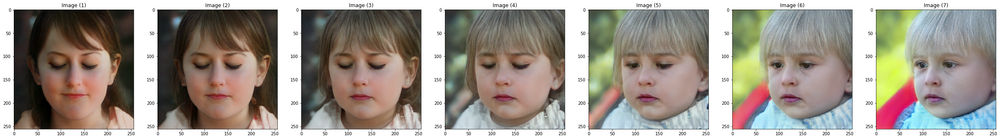

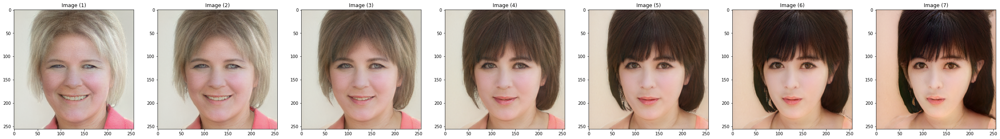

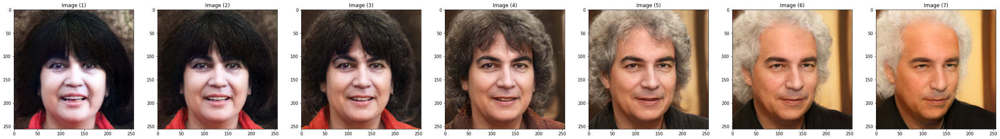

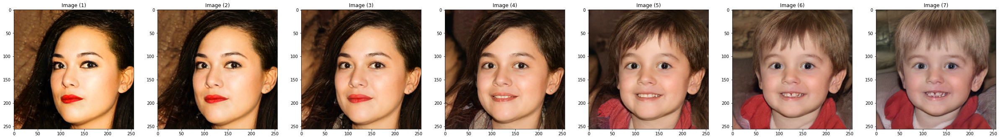

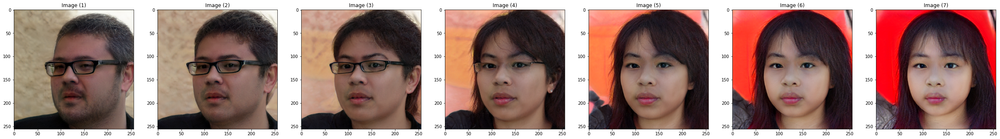

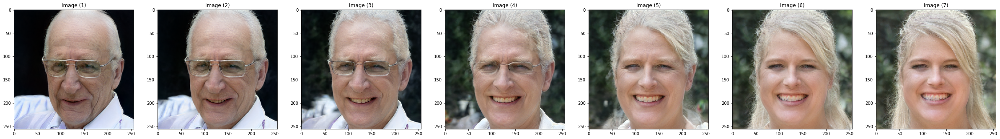

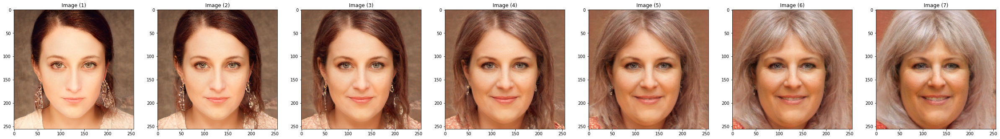

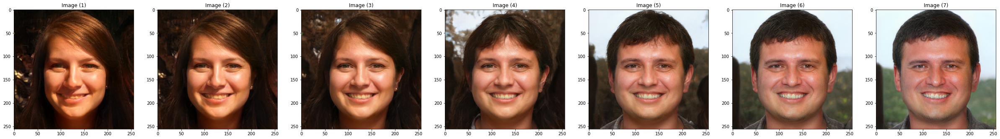

In [20]:
for i in interpolated_pair_imgs:
    show_images(interpolated_pair_imgs[i])
    
    

# W PLUS

In [7]:
latent_path =  "./projected_output/interpolate_pairs/projected_W_PLUS_1000step_256_550000/projected_latent_dict"
latent_files = os.listdir(latent_path)
wplus_latent_pairs = defaultdict(lambda: defaultdict(str))
for latent_file in latent_files:
    img_id, img_tag =  latent_file.split("_")[:2]
    with open(osp.join(latent_path,latent_file),'rb') as f:
        wplus_latent_pairs[img_id][img_tag] = torch.load(f)
print(f"there are {len(latent_files)} latent files")

there are 16 latent files


In [8]:
wplus_latent_pairs['0']['a']['latent'].shape

torch.Size([14, 512])

In [14]:
wplus_interpolated_pair_imgs = make_pair_interpolate(wplus_latent_pairs,w_plus=True)

/home/nessessence/Documents/DDPM/stylegan2-pytorch/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.3.1. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."


/home/nessessence/anaconda3/envs/stylegan/lib/python3.6/site-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


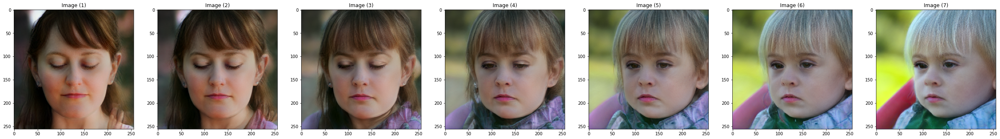

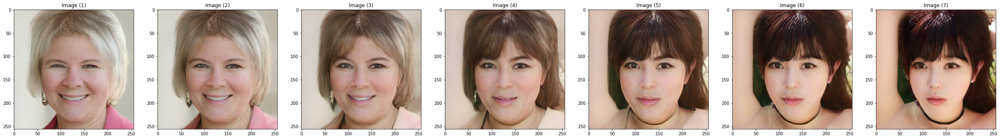

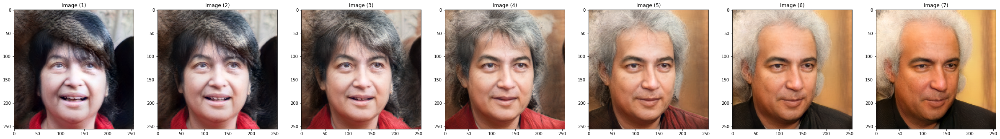

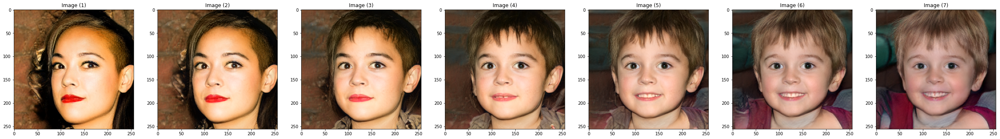

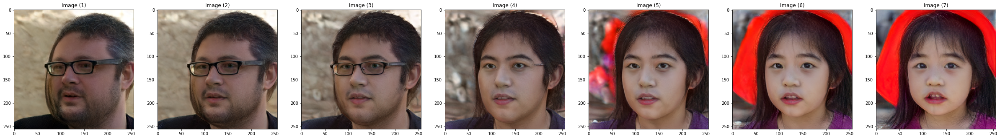

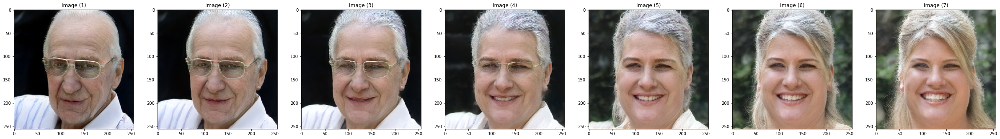

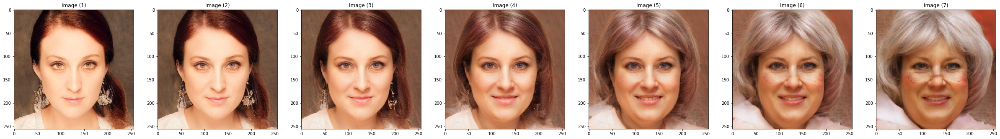

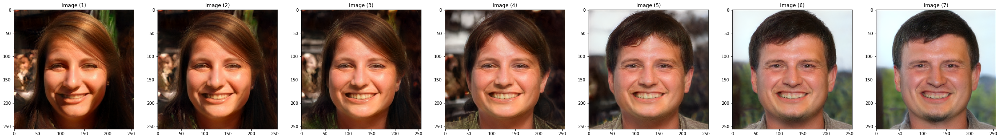

In [18]:
for i in wplus_interpolated_pair_imgs:
    show_images(wplus_interpolated_pair_imgs[i])